In [4]:
import numpy as np
import matplotlib.pyplot as plt

from Crypto.Cipher import AES
from Crypto.Random import get_random_bytes
import cv2

import cv2
import matplotlib.pyplot as plt
import numpy as np
import math as m

In [12]:
def biohashing(Γ, M, m, k, τ):
    # Step 1: Generate pseudo-random vectors {ri} based on user's seed k
    np.random.seed(k)
    r = np.random.rand(m, M)
    
    # Step 2: Apply Gram-Schmidt process to transform r into an orthonormal set of matrices
    r_orthogonal = np.array([r[0]])
    for i in range(1, m):
        ri = r[i]
        for j in range(i):
            ri -= np.dot(r[i], r_orthogonal[j]) * r_orthogonal[j]
        ri /= np.linalg.norm(ri)
        r_orthogonal = np.vstack([r_orthogonal, ri])
    
    # Step 3: Compute ⟨Γ, r⊥i⟩ for each r⊥i
    inner_products = np.dot(Γ, r_orthogonal.T)
    
    # Step 4: Compute m bits BioHash {bi}
    bi = []
    for i in range(m):
        if inner_products[i] <= τ:
            bi.append(0)
        else:
            bi.append(1)
    
    return bi

# Example usage:
Γ = np.array([0.2627450980392157, 0.2627450980392157, 0.2627450980392157, 0.26666666666666666, 0.26666666666666666, 0.26666666666666666, 0.27450980392156865, 0.27450980392156865, 0.27450980392156865, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.803921568627451, 0.803921568627451, 0.803921568627451, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.9411764705882353, 0.9411764705882353, 0.9411764705882353, 0.27058823529411763, 0.27058823529411763, 0.27058823529411763, 0.26666666666666666, 0.26666666666666666, 0.26666666666666666, 0.26666666666666666, 0.26666666666666666, 0.26666666666666666, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.9372549019607843, 0.9372549019607843, 0.9372549019607843, 0.27058823529411763, 0.27058823529411763, 0.27058823529411763, 0.27450980392156865, 0.27450980392156865, 0.27450980392156865, 0.27450980392156865, 0.27450980392156865, 0.27450980392156865, 0.27450980392156865, 0.27450980392156865, 0.27450980392156865, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.6, 0.6, 0.6, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6, 0.6, 0.6, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6, 0.6, 0.6, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.8235294117647058, 0.8235294117647058, 0.8235294117647058, 0.9058823529411765, 0.9058823529411765, 0.9058823529411765, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.27058823529411763, 0.27058823529411763, 0.27058823529411763, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6, 0.6, 0.6, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6, 0.6, 0.6, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.796078431372549, 0.796078431372549, 0.796078431372549, 0.8784313725490196, 0.8784313725490196, 0.8784313725490196, 0.27450980392156865, 0.27450980392156865, 0.27450980392156865, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6, 0.6, 0.6, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6, 0.6, 0.6, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.6, 0.6, 0.6, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.27058823529411763, 0.27058823529411763, 0.27058823529411763, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.6, 0.6, 0.6, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.8352941176470589, 0.8352941176470589, 0.8352941176470589, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.27450980392156865, 0.27450980392156865, 0.27450980392156865, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.807843137254902, 0.807843137254902, 0.807843137254902, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6, 0.6, 0.6, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.6, 0.6, 0.6, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6, 0.6, 0.6, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4, 0.4, 0.4, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4, 0.4, 0.4, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.4, 0.4, 0.4, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.6, 0.6, 0.6, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6, 0.6, 0.6, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.6, 0.6, 0.6, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6, 0.6, 0.6, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4, 0.4, 0.4, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2784313725490196, 0.2784313725490196, 0.2784313725490196, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6, 0.6, 0.6, 0.6, 0.6, 0.6, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4, 0.4, 0.4, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6, 0.6, 0.6, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4, 0.4, 0.4, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.27450980392156865, 0.27450980392156865, 0.27450980392156865, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6, 0.6, 0.6, 0.6, 0.6, 0.6, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6, 0.6, 0.6, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.6, 0.6, 0.6, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6, 0.6, 0.6, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.2823529411764706, 0.2823529411764706, 0.2823529411764706, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.4, 0.4, 0.4, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4, 0.4, 0.4, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4, 0.4, 0.4, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.2901960784313726, 0.2901960784313726, 0.2901960784313726, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4, 0.4, 0.4, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.28627450980392155, 0.28627450980392155, 0.28627450980392155, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.4, 0.4, 0.4, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.6, 0.6, 0.6, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4, 0.4, 0.4, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4, 0.4, 0.4, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4, 0.4, 0.4, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.6, 0.6, 0.6, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4, 0.4, 0.4, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4, 0.4, 0.4, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6, 0.6, 0.6, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.4, 0.4, 0.4, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6, 0.6, 0.6, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4, 0.4, 0.4, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.6, 0.6, 0.6, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6, 0.6, 0.6, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4, 0.4, 0.4, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7725490196078432, 0.7725490196078432, 0.7725490196078432, 0.803921568627451, 0.803921568627451, 0.803921568627451, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4, 0.4, 0.4, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7725490196078432, 0.7725490196078432, 0.7725490196078432, 0.8235294117647058, 0.8235294117647058, 0.8235294117647058, 0.8, 0.8, 0.8, 0.7725490196078432, 0.7725490196078432, 0.7725490196078432, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4, 0.4, 0.4, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.4, 0.4, 0.4, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.8, 0.8, 0.8, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.8196078431372549, 0.8196078431372549, 0.8196078431372549, 0.8, 0.8, 0.8, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.4, 0.4, 0.4, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7686274509803922, 0.7686274509803922, 0.7686274509803922, 0.803921568627451, 0.803921568627451, 0.803921568627451, 0.8313725490196079, 0.8313725490196079, 0.8313725490196079, 0.8352941176470589, 0.8352941176470589, 0.8352941176470589, 0.8, 0.8, 0.8, 0.8117647058823529, 0.8117647058823529, 0.8117647058823529, 0.788235294117647, 0.788235294117647, 0.788235294117647, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6, 0.6, 0.6, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.8352941176470589, 0.8352941176470589, 0.8352941176470589, 0.8117647058823529, 0.8117647058823529, 0.8117647058823529, 0.8196078431372549, 0.8196078431372549, 0.8196078431372549, 0.8, 0.8, 0.8, 0.7686274509803922, 0.7686274509803922, 0.7686274509803922, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7686274509803922, 0.7686274509803922, 0.7686274509803922, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8313725490196079, 0.8313725490196079, 0.8313725490196079, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.807843137254902, 0.807843137254902, 0.807843137254902, 0.792156862745098, 0.792156862745098, 0.792156862745098, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8352941176470589, 0.8352941176470589, 0.8352941176470589, 0.8431372549019608, 0.8431372549019608, 0.8431372549019608, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.792156862745098, 0.792156862745098, 0.792156862745098, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7803921568627451, 0.7803921568627451, 0.7803921568627451, 0.8470588235294118, 0.8470588235294118, 0.8470588235294118, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.8470588235294118, 0.8470588235294118, 0.8470588235294118, 0.8549019607843137, 0.8549019607843137, 0.8549019607843137, 0.8431372549019608, 0.8431372549019608, 0.8431372549019608, 0.807843137254902, 0.807843137254902, 0.807843137254902, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6, 0.6, 0.6, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4, 0.4, 0.4, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.4, 0.4, 0.4, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.792156862745098, 0.792156862745098, 0.792156862745098, 0.8470588235294118, 0.8470588235294118, 0.8470588235294118, 0.8549019607843137, 0.8549019607843137, 0.8549019607843137, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8549019607843137, 0.8549019607843137, 0.8549019607843137, 0.8431372549019608, 0.8431372549019608, 0.8431372549019608, 0.8352941176470589, 0.8352941176470589, 0.8352941176470589, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6, 0.6, 0.6, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4, 0.4, 0.4, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.792156862745098, 0.792156862745098, 0.792156862745098, 0.8352941176470589, 0.8352941176470589, 0.8352941176470589, 0.8549019607843137, 0.8549019607843137, 0.8549019607843137, 0.8549019607843137, 0.8549019607843137, 0.8549019607843137, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8470588235294118, 0.8470588235294118, 0.8470588235294118, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.8313725490196079, 0.8313725490196079, 0.8313725490196079, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6, 0.6, 0.6, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4, 0.4, 0.4, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.7803921568627451, 0.7803921568627451, 0.7803921568627451, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.8784313725490196, 0.8784313725490196, 0.8784313725490196, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.8352941176470589, 0.8352941176470589, 0.8352941176470589, 0.8470588235294118, 0.8470588235294118, 0.8470588235294118, 0.8352941176470589, 0.8352941176470589, 0.8352941176470589, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.4, 0.4, 0.4, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8627450980392157, 0.8627450980392157, 0.8627450980392157, 0.8470588235294118, 0.8470588235294118, 0.8470588235294118, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4, 0.4, 0.4, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.6, 0.6, 0.6, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.788235294117647, 0.788235294117647, 0.788235294117647, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8784313725490196, 0.8784313725490196, 0.8784313725490196, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4, 0.4, 0.4, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.796078431372549, 0.796078431372549, 0.796078431372549, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8941176470588236, 0.8941176470588236, 0.8941176470588236, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8627450980392157, 0.8627450980392157, 0.8627450980392157, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8549019607843137, 0.8549019607843137, 0.8549019607843137, 0.7803921568627451, 0.7803921568627451, 0.7803921568627451, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4, 0.4, 0.4, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.803921568627451, 0.803921568627451, 0.803921568627451, 0.8627450980392157, 0.8627450980392157, 0.8627450980392157, 0.8784313725490196, 0.8784313725490196, 0.8784313725490196, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.792156862745098, 0.792156862745098, 0.792156862745098, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4, 0.4, 0.4, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.8, 0.8, 0.8, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8627450980392157, 0.8627450980392157, 0.8627450980392157, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.792156862745098, 0.792156862745098, 0.792156862745098, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4, 0.4, 0.4, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.796078431372549, 0.796078431372549, 0.796078431372549, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8941176470588236, 0.8941176470588236, 0.8941176470588236, 0.8549019607843137, 0.8549019607843137, 0.8549019607843137, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.792156862745098, 0.792156862745098, 0.792156862745098, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4, 0.4, 0.4, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.8117647058823529, 0.8117647058823529, 0.8117647058823529, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.792156862745098, 0.792156862745098, 0.792156862745098, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.8117647058823529, 0.8117647058823529, 0.8117647058823529, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8941176470588236, 0.8941176470588236, 0.8941176470588236, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.796078431372549, 0.796078431372549, 0.796078431372549, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.4, 0.4, 0.4, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.8352941176470589, 0.8352941176470589, 0.8352941176470589, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8980392156862745, 0.8980392156862745, 0.8980392156862745, 0.8941176470588236, 0.8941176470588236, 0.8941176470588236, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.8980392156862745, 0.8980392156862745, 0.8980392156862745, 0.796078431372549, 0.796078431372549, 0.796078431372549, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4, 0.4, 0.4, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7686274509803922, 0.7686274509803922, 0.7686274509803922, 0.8352941176470589, 0.8352941176470589, 0.8352941176470589, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.8784313725490196, 0.8784313725490196, 0.8784313725490196, 0.9058823529411765, 0.9058823529411765, 0.9058823529411765, 0.8980392156862745, 0.8980392156862745, 0.8980392156862745, 0.8941176470588236, 0.8941176470588236, 0.8941176470588236, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.788235294117647, 0.788235294117647, 0.788235294117647, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.6, 0.6, 0.6, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7803921568627451, 0.7803921568627451, 0.7803921568627451, 0.8431372549019608, 0.8431372549019608, 0.8431372549019608, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.9176470588235294, 0.9176470588235294, 0.9176470588235294, 0.8941176470588236, 0.8941176470588236, 0.8941176470588236, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8941176470588236, 0.8941176470588236, 0.8941176470588236, 0.792156862745098, 0.792156862745098, 0.792156862745098, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.4, 0.4, 0.4, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7803921568627451, 0.7803921568627451, 0.7803921568627451, 0.8431372549019608, 0.8431372549019608, 0.8431372549019608, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.9137254901960784, 0.9137254901960784, 0.9137254901960784, 0.9058823529411765, 0.9058823529411765, 0.9058823529411765, 0.8980392156862745, 0.8980392156862745, 0.8980392156862745, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8941176470588236, 0.8941176470588236, 0.8941176470588236, 0.7803921568627451, 0.7803921568627451, 0.7803921568627451, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.4, 0.4, 0.4, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4, 0.4, 0.4, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.8352941176470589, 0.8352941176470589, 0.8352941176470589, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8941176470588236, 0.8941176470588236, 0.8941176470588236, 0.9019607843137255, 0.9019607843137255, 0.9019607843137255, 0.9098039215686274, 0.9098039215686274, 0.9098039215686274, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4, 0.4, 0.4, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7803921568627451, 0.7803921568627451, 0.7803921568627451, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.9019607843137255, 0.9019607843137255, 0.9019607843137255, 0.9098039215686274, 0.9098039215686274, 0.9098039215686274, 0.9137254901960784, 0.9137254901960784, 0.9137254901960784, 0.8980392156862745, 0.8980392156862745, 0.8980392156862745, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.7803921568627451, 0.7803921568627451, 0.7803921568627451, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6, 0.6, 0.6, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.8431372549019608, 0.8431372549019608, 0.8431372549019608, 0.8784313725490196, 0.8784313725490196, 0.8784313725490196, 0.9058823529411765, 0.9058823529411765, 0.9058823529411765, 0.8941176470588236, 0.8941176470588236, 0.8941176470588236, 0.9098039215686274, 0.9098039215686274, 0.9098039215686274, 0.8980392156862745, 0.8980392156862745, 0.8980392156862745, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8627450980392157, 0.8627450980392157, 0.8627450980392157, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4, 0.4, 0.4, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.8470588235294118, 0.8470588235294118, 0.8470588235294118, 0.9019607843137255, 0.9019607843137255, 0.9019607843137255, 0.9058823529411765, 0.9058823529411765, 0.9058823529411765, 0.9098039215686274, 0.9098039215686274, 0.9098039215686274, 0.9019607843137255, 0.9019607843137255, 0.9019607843137255, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8784313725490196, 0.8784313725490196, 0.8784313725490196, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.8941176470588236, 0.8941176470588236, 0.8941176470588236, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.9098039215686274, 0.9098039215686274, 0.9098039215686274, 0.8980392156862745, 0.8980392156862745, 0.8980392156862745, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8627450980392157, 0.8627450980392157, 0.8627450980392157, 0.7686274509803922, 0.7686274509803922, 0.7686274509803922, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7686274509803922, 0.7686274509803922, 0.7686274509803922, 0.796078431372549, 0.796078431372549, 0.796078431372549, 0.8313725490196079, 0.8313725490196079, 0.8313725490196079, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.9019607843137255, 0.9019607843137255, 0.9019607843137255, 0.8980392156862745, 0.8980392156862745, 0.8980392156862745, 0.9019607843137255, 0.9019607843137255, 0.9019607843137255, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8549019607843137, 0.8549019607843137, 0.8549019607843137, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6, 0.6, 0.6, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.8, 0.8, 0.8, 0.8235294117647058, 0.8235294117647058, 0.8235294117647058, 0.9058823529411765, 0.9058823529411765, 0.9058823529411765, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8980392156862745, 0.8980392156862745, 0.8980392156862745, 0.8941176470588236, 0.8941176470588236, 0.8941176470588236, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.7686274509803922, 0.7686274509803922, 0.7686274509803922, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6, 0.6, 0.6, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4, 0.4, 0.4, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7725490196078432, 0.7725490196078432, 0.7725490196078432, 0.788235294117647, 0.788235294117647, 0.788235294117647, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.8784313725490196, 0.8784313725490196, 0.8784313725490196, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.9098039215686274, 0.9098039215686274, 0.9098039215686274, 0.9019607843137255, 0.9019607843137255, 0.9019607843137255, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.8627450980392157, 0.8627450980392157, 0.8627450980392157, 0.7686274509803922, 0.7686274509803922, 0.7686274509803922, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6, 0.6, 0.6, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6, 0.6, 0.6, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.796078431372549, 0.796078431372549, 0.796078431372549, 0.8156862745098039, 0.8156862745098039, 0.8156862745098039, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8980392156862745, 0.8980392156862745, 0.8980392156862745, 0.9019607843137255, 0.9019607843137255, 0.9019607843137255, 0.8784313725490196, 0.8784313725490196, 0.8784313725490196, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8549019607843137, 0.8549019607843137, 0.8549019607843137, 0.7803921568627451, 0.7803921568627451, 0.7803921568627451, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.6, 0.6, 0.6, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.4, 0.4, 0.4, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.788235294117647, 0.788235294117647, 0.788235294117647, 0.8470588235294118, 0.8470588235294118, 0.8470588235294118, 0.9019607843137255, 0.9019607843137255, 0.9019607843137255, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8980392156862745, 0.8980392156862745, 0.8980392156862745, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8549019607843137, 0.8549019607843137, 0.8549019607843137, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4, 0.4, 0.4, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7803921568627451, 0.7803921568627451, 0.7803921568627451, 0.8470588235294118, 0.8470588235294118, 0.8470588235294118, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.8470588235294118, 0.8470588235294118, 0.8470588235294118, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.7686274509803922, 0.7686274509803922, 0.7686274509803922, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7725490196078432, 0.7725490196078432, 0.7725490196078432, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8941176470588236, 0.8941176470588236, 0.8941176470588236, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8627450980392157, 0.8627450980392157, 0.8627450980392157, 0.8470588235294118, 0.8470588235294118, 0.8470588235294118, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.7686274509803922, 0.7686274509803922, 0.7686274509803922, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.792156862745098, 0.792156862745098, 0.792156862745098, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8862745098039215, 0.8862745098039215, 0.8862745098039215, 0.8784313725490196, 0.8784313725490196, 0.8784313725490196, 0.8627450980392157, 0.8627450980392157, 0.8627450980392157, 0.8549019607843137, 0.8549019607843137, 0.8549019607843137, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6, 0.6, 0.6, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.8, 0.8, 0.8, 0.8470588235294118, 0.8470588235294118, 0.8470588235294118, 0.8784313725490196, 0.8784313725490196, 0.8784313725490196, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8235294117647058, 0.8235294117647058, 0.8235294117647058, 0.8313725490196079, 0.8313725490196079, 0.8313725490196079, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.8, 0.8, 0.8, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8352941176470589, 0.8352941176470589, 0.8352941176470589, 0.8196078431372549, 0.8196078431372549, 0.8196078431372549, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4, 0.4, 0.4, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.796078431372549, 0.796078431372549, 0.796078431372549, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8901960784313725, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8313725490196079, 0.8313725490196079, 0.8313725490196079, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.8117647058823529, 0.8117647058823529, 0.8117647058823529, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.8352941176470589, 0.8352941176470589, 0.8352941176470589, 0.8823529411764706, 0.8823529411764706, 0.8823529411764706, 0.8941176470588236, 0.8941176470588236, 0.8941176470588236, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8313725490196079, 0.8313725490196079, 0.8313725490196079, 0.8, 0.8, 0.8, 0.8196078431372549, 0.8196078431372549, 0.8196078431372549, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.788235294117647, 0.788235294117647, 0.788235294117647, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8745098039215686, 0.8745098039215686, 0.8745098039215686, 0.8627450980392157, 0.8627450980392157, 0.8627450980392157, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.807843137254902, 0.807843137254902, 0.807843137254902, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4, 0.4, 0.4, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6, 0.6, 0.6, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7725490196078432, 0.7725490196078432, 0.7725490196078432, 0.8313725490196079, 0.8313725490196079, 0.8313725490196079, 0.8666666666666667, 0.8666666666666667, 0.8666666666666667, 0.8784313725490196, 0.8784313725490196, 0.8784313725490196, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.8196078431372549, 0.8196078431372549, 0.8196078431372549, 0.807843137254902, 0.807843137254902, 0.807843137254902, 0.807843137254902, 0.807843137254902, 0.807843137254902, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.8156862745098039, 0.8156862745098039, 0.8156862745098039, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8705882352941177, 0.8705882352941177, 0.8705882352941177, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8235294117647058, 0.8235294117647058, 0.8235294117647058, 0.807843137254902, 0.807843137254902, 0.807843137254902, 0.796078431372549, 0.796078431372549, 0.796078431372549, 0.792156862745098, 0.792156862745098, 0.792156862745098, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7725490196078432, 0.7725490196078432, 0.7725490196078432, 0.8117647058823529, 0.8117647058823529, 0.8117647058823529, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8156862745098039, 0.8156862745098039, 0.8156862745098039, 0.796078431372549, 0.796078431372549, 0.796078431372549, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.6, 0.6, 0.6, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4, 0.4, 0.4, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.6, 0.6, 0.6, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.8117647058823529, 0.8117647058823529, 0.8117647058823529, 0.8627450980392157, 0.8627450980392157, 0.8627450980392157, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8509803921568627, 0.8117647058823529, 0.8117647058823529, 0.8117647058823529, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.8, 0.8, 0.8, 0.8588235294117647, 0.8588235294117647, 0.8588235294117647, 0.8470588235294118, 0.8470588235294118, 0.8470588235294118, 0.8196078431372549, 0.8196078431372549, 0.8196078431372549, 0.803921568627451, 0.803921568627451, 0.803921568627451, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6, 0.6, 0.6, 0.6, 0.6, 0.6, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6, 0.6, 0.6, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.796078431372549, 0.796078431372549, 0.796078431372549, 0.8392156862745098, 0.8392156862745098, 0.8392156862745098, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.803921568627451, 0.803921568627451, 0.803921568627451, 0.788235294117647, 0.788235294117647, 0.788235294117647, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4, 0.4, 0.4, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.788235294117647, 0.788235294117647, 0.788235294117647, 0.8470588235294118, 0.8470588235294118, 0.8470588235294118, 0.8352941176470589, 0.8352941176470589, 0.8352941176470589, 0.8196078431372549, 0.8196078431372549, 0.8196078431372549, 0.7803921568627451, 0.7803921568627451, 0.7803921568627451, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4, 0.4, 0.4, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6, 0.6, 0.6, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.803921568627451, 0.803921568627451, 0.803921568627451, 0.8313725490196079, 0.8313725490196079, 0.8313725490196079, 0.8313725490196079, 0.8313725490196079, 0.8313725490196079, 0.807843137254902, 0.807843137254902, 0.807843137254902, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6, 0.6, 0.6, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4, 0.4, 0.4, 0.4, 0.4, 0.4, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.4, 0.4, 0.4, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.6, 0.6, 0.6, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.7764705882352941, 0.7764705882352941, 0.7764705882352941, 0.8313725490196079, 0.8313725490196079, 0.8313725490196079, 0.8156862745098039, 0.8156862745098039, 0.8156862745098039, 0.788235294117647, 0.788235294117647, 0.788235294117647, 0.7686274509803922, 0.7686274509803922, 0.7686274509803922, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6, 0.6, 0.6, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4, 0.4, 0.4, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.7803921568627451, 0.7803921568627451, 0.7803921568627451, 0.8431372549019608, 0.8431372549019608, 0.8431372549019608, 0.807843137254902, 0.807843137254902, 0.807843137254902, 0.788235294117647, 0.788235294117647, 0.788235294117647, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.7803921568627451, 0.7803921568627451, 0.7803921568627451, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.8117647058823529, 0.8117647058823529, 0.8117647058823529, 0.796078431372549, 0.796078431372549, 0.796078431372549, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6, 0.6, 0.6, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7686274509803922, 0.7686274509803922, 0.7686274509803922, 0.8156862745098039, 0.8156862745098039, 0.8156862745098039, 0.8, 0.8, 0.8, 0.792156862745098, 0.792156862745098, 0.792156862745098, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4, 0.4, 0.4, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6, 0.6, 0.6, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.8235294117647058, 0.8235294117647058, 0.8235294117647058, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.7725490196078432, 0.7725490196078432, 0.7725490196078432, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6, 0.6, 0.6, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4, 0.4, 0.4, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.4, 0.4, 0.4, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.6, 0.6, 0.6, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.4823529411764706, 0.4823529411764706, 0.4823529411764706, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.6, 0.6, 0.6, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.8274509803921568, 0.8274509803921568, 0.8274509803921568, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.7686274509803922, 0.7686274509803922, 0.7686274509803922, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4, 0.4, 0.4, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.6, 0.6, 0.6, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.6078431372549019, 0.6078431372549019, 0.6078431372549019, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.8156862745098039, 0.8156862745098039, 0.8156862745098039, 0.792156862745098, 0.792156862745098, 0.792156862745098, 0.7725490196078432, 0.7725490196078432, 0.7725490196078432, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6, 0.6, 0.6, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.30980392156862746, 0.30980392156862746, 0.30980392156862746, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.4117647058823529, 0.4117647058823529, 0.4117647058823529, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.47058823529411764, 0.47058823529411764, 0.47058823529411764, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.6, 0.6, 0.6, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.8117647058823529, 0.8117647058823529, 0.8117647058823529, 0.7725490196078432, 0.7725490196078432, 0.7725490196078432, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.7686274509803922, 0.7686274509803922, 0.7686274509803922, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3215686274509804, 0.3215686274509804, 0.3215686274509804, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.4, 0.4, 0.4, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4196078431372549, 0.4196078431372549, 0.4196078431372549, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.6, 0.6, 0.6, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.8, 0.8, 0.8, 0.7725490196078432, 0.7725490196078432, 0.7725490196078432, 0.7529411764705882, 0.7529411764705882, 0.7529411764705882, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6823529411764706, 0.6823529411764706, 0.6823529411764706, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.5882352941176471, 0.5882352941176471, 0.5882352941176471, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3254901960784314, 0.3254901960784314, 0.3254901960784314, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.43137254901960786, 0.43137254901960786, 0.43137254901960786, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7411764705882353, 0.7411764705882353, 0.7411764705882353, 0.7490196078431373, 0.7490196078431373, 0.7490196078431373, 0.7647058823529411, 0.7647058823529411, 0.7647058823529411, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6313725490196078, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.611764705882353, 0.611764705882353, 0.611764705882353, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5450980392156862, 0.5450980392156862, 0.5450980392156862, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.29411764705882354, 0.29411764705882354, 0.29411764705882354, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.32941176470588235, 0.32941176470588235, 0.32941176470588235, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.4, 0.4, 0.4, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.44313725490196076, 0.44313725490196076, 0.44313725490196076, 0.4470588235294118, 0.4470588235294118, 0.4470588235294118, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5647058823529412, 0.5647058823529412, 0.5647058823529412, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.8, 0.8, 0.8, 0.7725490196078432, 0.7725490196078432, 0.7725490196078432, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.6745098039215687, 0.6745098039215687, 0.6745098039215687, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.43529411764705883, 0.43529411764705883, 0.43529411764705883, 0.4, 0.4, 0.4, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6784313725490196, 0.6784313725490196, 0.6784313725490196, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5215686274509804, 0.5215686274509804, 0.5215686274509804, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.6, 0.6, 0.6, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.2980392156862745, 0.2980392156862745, 0.2980392156862745, 0.3058823529411765, 0.3058823529411765, 0.3058823529411765, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4627450980392157, 0.4627450980392157, 0.4627450980392157, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.6, 0.6, 0.6, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7568627450980392, 0.7568627450980392, 0.7568627450980392, 0.8, 0.8, 0.8, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7058823529411765, 0.7058823529411765, 0.7058823529411765, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5058823529411764, 0.5058823529411764, 0.5058823529411764, 0.4588235294117647, 0.4588235294117647, 0.4588235294117647, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.4, 0.4, 0.4, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.38823529411764707, 0.38823529411764707, 0.38823529411764707, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.37254901960784315, 0.37254901960784315, 0.37254901960784315, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.48627450980392156, 0.48627450980392156, 0.48627450980392156, 0.5137254901960784, 0.5137254901960784, 0.5137254901960784, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7450980392156863, 0.7450980392156863, 0.7450980392156863, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6352941176470588, 0.6352941176470588, 0.6352941176470588, 0.6274509803921569, 0.6274509803921569, 0.6274509803921569, 0.596078431372549, 0.596078431372549, 0.596078431372549, 0.5843137254901961, 0.5843137254901961, 0.5843137254901961, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5294117647058824, 0.5294117647058824, 0.5294117647058824, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5490196078431373, 0.5490196078431373, 0.5490196078431373, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.6, 0.6, 0.6, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.30196078431372547, 0.30196078431372547, 0.30196078431372547, 0.3137254901960784, 0.3137254901960784, 0.3137254901960784, 0.3176470588235294, 0.3176470588235294, 0.3176470588235294, 0.34509803921568627, 0.34509803921568627, 0.34509803921568627, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.33725490196078434, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.36470588235294116, 0.36470588235294116, 0.36470588235294116, 0.3686274509803922, 0.3686274509803922, 0.3686274509803922, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.396078431372549, 0.396078431372549, 0.396078431372549, 0.40784313725490196, 0.40784313725490196, 0.40784313725490196, 0.41568627450980394, 0.41568627450980394, 0.41568627450980394, 0.4392156862745098, 0.4392156862745098, 0.4392156862745098, 0.4549019607843137, 0.4549019607843137, 0.4549019607843137, 0.4666666666666667, 0.4666666666666667, 0.4666666666666667, 0.47843137254901963, 0.47843137254901963, 0.47843137254901963, 0.49411764705882355, 0.49411764705882355, 0.49411764705882355, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6901960784313725, 0.6901960784313725, 0.6901960784313725, 0.7176470588235294, 0.7176470588235294, 0.7176470588235294, 0.7372549019607844, 0.7372549019607844, 0.7372549019607844, 0.7803921568627451, 0.7803921568627451, 0.7803921568627451, 0.7607843137254902, 0.7607843137254902, 0.7607843137254902, 0.7294117647058823, 0.7294117647058823, 0.7294117647058823, 0.7254901960784313, 0.7254901960784313, 0.7254901960784313, 0.6705882352941176, 0.6705882352941176, 0.6705882352941176, 0.6549019607843137, 0.6549019607843137, 0.6549019607843137, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6235294117647059, 0.6235294117647059, 0.6235294117647059, 0.592156862745098, 0.592156862745098, 0.592156862745098, 0.5568627450980392, 0.5568627450980392, 0.5568627450980392, 0.5176470588235295, 0.5176470588235295, 0.5176470588235295, 0.49019607843137253, 0.49019607843137253, 0.49019607843137253, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4235294117647059, 0.4235294117647059, 0.4235294117647059, 0.403921568627451, 0.403921568627451, 0.403921568627451, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.3803921568627451, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3568627450980392, 0.3568627450980392, 0.3568627450980392, 0.3411764705882353, 0.3411764705882353, 0.3411764705882353, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.34901960784313724, 0.35294117647058826, 0.35294117647058826, 0.35294117647058826, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3607843137254902, 0.3764705882352941, 0.3764705882352941, 0.3764705882352941, 0.3843137254901961, 0.3843137254901961, 0.3843137254901961, 0.42745098039215684, 0.42745098039215684, 0.42745098039215684, 0.45098039215686275, 0.45098039215686275, 0.45098039215686275, 0.4745098039215686, 0.4745098039215686, 0.4745098039215686, 0.5098039215686274, 0.5098039215686274, 0.5098039215686274, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5803921568627451, 0.5803921568627451, 0.5803921568627451, 0.6196078431372549, 0.6196078431372549, 0.6196078431372549, 0.6509803921568628, 0.6509803921568628, 0.6509803921568628, 0.7098039215686275, 0.7098039215686275, 0.7098039215686275, 0.7137254901960784, 0.7137254901960784, 0.7137254901960784, 0.7333333333333333, 0.7333333333333333, 0.7333333333333333, 0.7215686274509804, 0.7215686274509804, 0.7215686274509804, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6980392156862745, 0.6941176470588235, 0.6941176470588235, 0.6941176470588235, 0.6862745098039216, 0.6862745098039216, 0.6862745098039216, 0.6627450980392157, 0.6627450980392157, 0.6627450980392157, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647, 0.6470588235294118, 0.6470588235294118, 0.6470588235294118, 0.6431372549019608, 0.6431372549019608, 0.6431372549019608, 0.6392156862745098, 0.6392156862745098, 0.6392156862745098, 0.6039215686274509, 0.6039215686274509, 0.6039215686274509, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5686274509803921, 0.5686274509803921, 0.5686274509803921, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5529411764705883, 0.5764705882352941, 0.5764705882352941, 0.5764705882352941, 0.5607843137254902, 0.5607843137254902, 0.5607843137254902, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5333333333333333, 0.5333333333333333, 0.5333333333333333, 0.5254901960784314, 0.5254901960784314, 0.5254901960784314, 0.5372549019607843, 0.5372549019607843, 0.5372549019607843, 0.5411764705882353, 0.5411764705882353, 0.5411764705882353, 0.5725490196078431, 0.5725490196078431, 0.5725490196078431, 0.615686274509804, 0.615686274509804, 0.615686274509804, 0.6588235294117647, 0.6588235294117647, 0.6588235294117647])
M = len(Γ)
m = 20# Replace with the desired length of the protected template
k = 202211050 # Replace with the user's seed
τ = 0.4  # Replace with the preset threshold

protected_template = biohashing(Γ, M, m, k, τ)
print(protected_template)


[1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1]


In [13]:
def get_binary(protected_template):
    binary_vector = protected_template.copy()
    
    binary_string = ''.join(map(str, binary_vector))
    
    # Convert the binary string to decimal
    decimal_value = int(binary_string, 2)
    
    return decimal_value
# print(decimal_value)


In [14]:
import os
os.getcwd()

'C:\\Users\\HK Joshi\\Documents\\Github\\major_project\\biocube'

In [6]:
os.chdir('..')

In [7]:
os.getcwd()

'C:\\Users\\HK Joshi\\Documents\\Github\\major_project\\biocube'

In [15]:
os.chdir('datasets\LR-VERA-fingervein')
os.getcwd()

'C:\\Users\\HK Joshi\\Documents\\Github\\major_project\\biocube\\datasets\\LR-VERA-fingervein'

In [16]:
import cv2
import numpy as np

k = 202211050 # Replace with the user's seed
m = 20# Replace with the desired length of the protected template
τ = 0.4  # Replace with the preset threshold

set_biohash = set()
count = 0
for folder in os.listdir():
    os.chdir(folder)
    count += 1
    k += 100
    for file_name in os.listdir():
        image = cv2.imread(file_name)
#         print(file_name)
        image_vector = image.flatten() / 255.0  # Normalize pixel values to the range [0, 1]
        # Print the vector
#         print(image_vector.tolist())  # Convert to a list for the desired forma
        
        # Example usage:
        Γ = image_vector.copy()
        M = len(Γ)
        
        biohash = biohashing(Γ, M, m, k, τ)
        print(k)
        binary_number = get_binary(biohash)
        set_biohash.add(str(binary_number))
        print(f'{file_name}: {binary_number}')
        
        break
    os.chdir('..')
    if count > 9:
        break

    # Resize the image to a specific size (e.g., 100x100 pixels)
#     width, height = 615, 149
#     resized_image = cv2.resize(image, (width, height))

    # Flatten the image into a 1D vector
#     image_vector = resized_image.flatten() / 255.0  # Normalize pixel values to the range [0, 1]

#     # Print the vector
#     print(image_vector.tolist())  # Convert to a list for the desired format


202211150
001_L_1.png: 524288
202211250
001_R_1.png: 524288
202211350
002_L_1.png: 526344
202211450
002_R_1.png: 524544
202211550
003_L_1.png: 590850
202211650
003_R_1.png: 565265
202211750
004_L_1.png: 525313
202211850
004_R_1.png: 524288
202211950
005_L_1.png: 524416
202212050
005_R_1.png: 532480


In [17]:
os.getcwd()

'C:\\Users\\HK Joshi\\Documents\\Github\\major_project\\biocube\\datasets\\LR-VERA-fingervein'

In [18]:
for ele in set_biohash:
    print(ele, end= ' ')

524288 526344 524416 590850 565265 524544 532480 525313 

In [19]:
os.chdir('..')
os.chdir('..')

In [20]:
os.getcwd()

'C:\\Users\\HK Joshi\\Documents\\Github\\major_project\\biocube'

## simple interchange

(-0.5, 251.5, 251.5, -0.5)

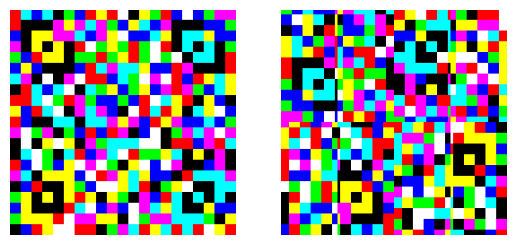

In [22]:
import cv2
import numpy as np

# Load the image

image_path = 'datasets\jabcode\jabcode_user_1.png'
image = cv2.imread(image_path)
orig_img = image.copy()

# Define the number of iterations
iterations = 10

# Perform the operations for each iteration
for i in range(iterations):
    # Divide the image into 4 equal parts
    height, width, channels = image.shape
    half_height = height // 2
    half_width = width // 2

    first_quarter = image[:half_height, :half_width]
    second_quarter = image[:half_height, half_width:]
    third_quarter = image[half_height:, :half_width]
    fourth_quarter = image[half_height:, half_width:]

    # Interchange the quarters
    new_image = np.vstack((second_quarter, first_quarter, fourth_quarter, third_quarter))

    # Rotate the image 90 degrees
    image = cv2.rotate(new_image, cv2.ROTATE_90_CLOCKWISE)

    # Display the intermediate result (optional)
#     cv2.imshow(f'Iteration {i+1}', image)
#     cv2.waitKey(0)
#     cv2.destroyAllWindows()

# Save the final result
# cv2.imwrite('final_image.png', image)

# Display the final result (optional)
# cv2.imshow('Final Image', image)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

plt.subplot(121)
plt.imshow(orig_img)
plt.axis('off')

plt.subplot(122)
plt.imshow(image)
plt.axis('off')

## xor

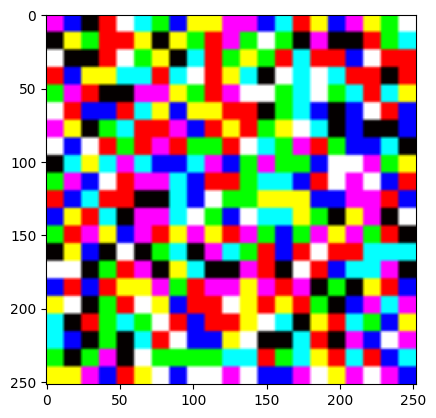

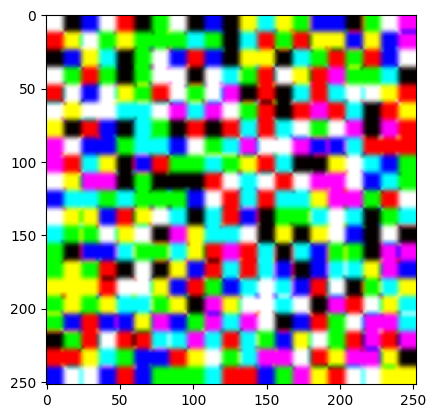

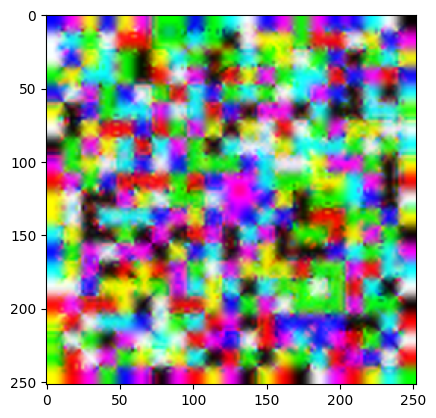

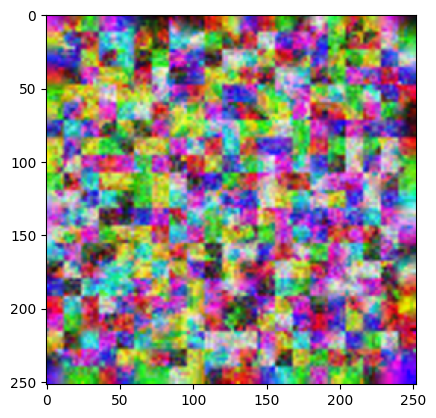

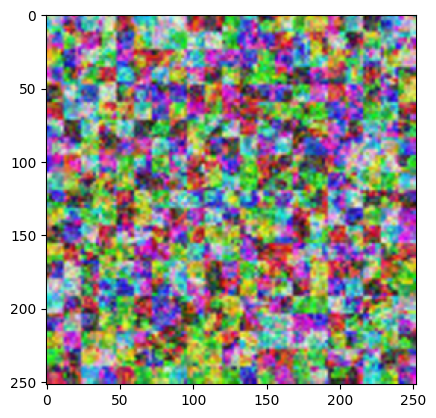

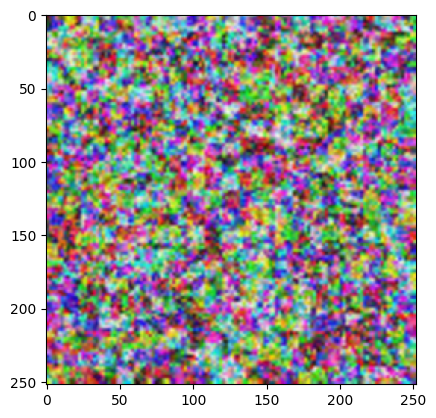

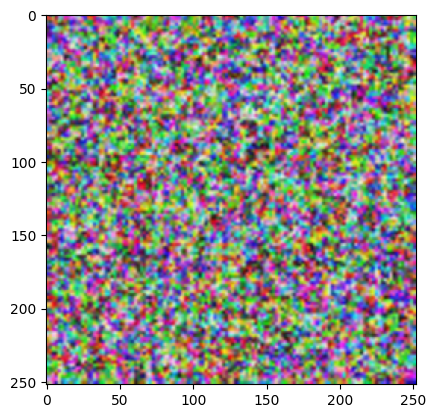

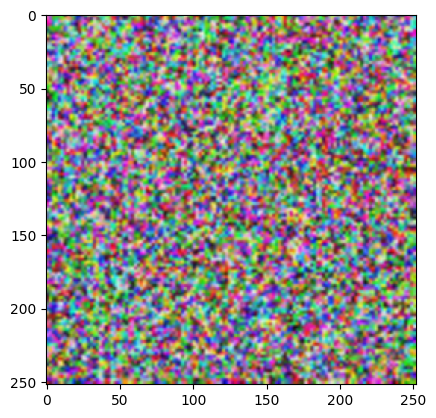

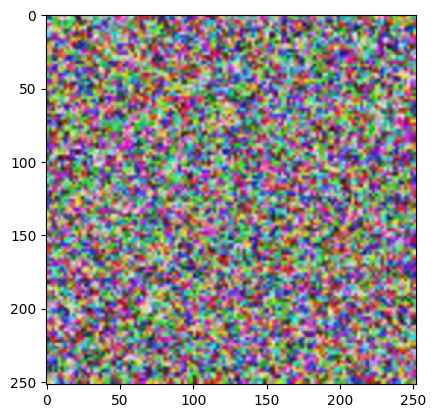

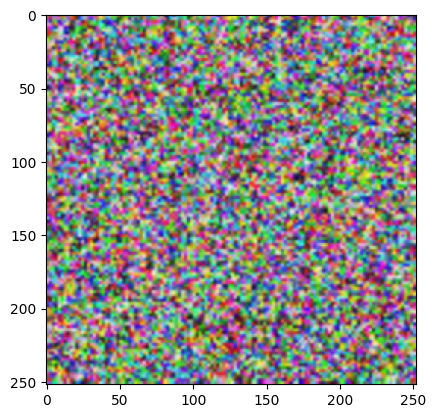

In [23]:
import cv2
import numpy as np

# Load the initial image
image_path = 'datasets\jabcode\jabcode_user_1.png'
original_image = cv2.imread(image_path)

# Define the number of iterations
num_iterations = 10

# Iterate through the desired number of iterations
for iteration in range(num_iterations):
    # Divide the image into 4 equal parts vertically
    height, width, _ = original_image.shape
    half_height = height // 2

    # Split the image into 4 parts
    part1 = original_image[:half_height, :]
    part2 = original_image[half_height:, :]

    # XOR operation between the 1st and 2nd part, and the 3rd and 4th part
    result1 = cv2.bitwise_xor(part1, part2)
    
    # Rotate the image by 90 degrees
    rotated_image = cv2.rotate(result1, cv2.ROTATE_90_CLOCKWISE)

    # Divide the rotated image into 4 equal parts vertically
    rotated_height, rotated_width, _ = rotated_image.shape
    rotated_half_height = rotated_height // 2

    # Split the rotated image into 4 parts
    rotated_part1 = rotated_image[:rotated_half_height, :]
    rotated_part2 = rotated_image[rotated_half_height:, :]

    # XOR operation between the 1st and 2nd part, and the 3rd and 4th part
    result2 = cv2.bitwise_xor(rotated_part1, rotated_part2)

    # Rotate the result by 90 degrees
    final_result = cv2.rotate(result2, cv2.ROTATE_90_CLOCKWISE)

    # Increase each pixel by 4
    final_result = cv2.add(final_result, 4)

    # Resize the result back to the original dimensions
    final_result = cv2.resize(final_result, (width, height))

    # Display the image for this iteration
#     cv2.imshow(f'Iteration {iteration + 1}', final_result)

    # Update the original image for the next iteration
    original_image = final_result

    plt.imshow(original_image)
    plt.show()

## XOR with median filtering

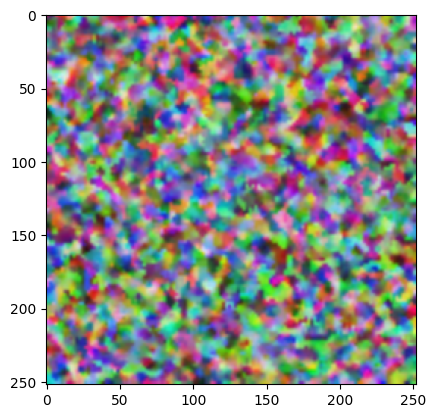

In [24]:
import cv2
import numpy as np

# Load the initial image
image_path = 'datasets\jabcode\jabcode_user_1.png'
original_image = cv2.imread(image_path)

# Define the number of iterations
num_iterations = 10

# Iterate through the desired number of iterations
for iteration in range(num_iterations):
    # Divide the image into 4 equal parts vertically
    height, width, _ = original_image.shape
    half_height = height // 2

    # Split the image into 4 parts
    part1 = original_image[:half_height, :]
    part2 = original_image[half_height:, :]

    # XOR operation between the 1st and 2nd part, and the 3rd and 4th part
    result1 = cv2.bitwise_xor(part1, part2)
    
    # Rotate the image by 90 degrees
    rotated_image = cv2.rotate(result1, cv2.ROTATE_90_CLOCKWISE)

    # Divide the rotated image into 4 equal parts vertically
    rotated_height, rotated_width, _ = rotated_image.shape
    rotated_half_height = rotated_height // 2

    # Split the rotated image into 4 parts
    rotated_part1 = rotated_image[:rotated_half_height, :]
    rotated_part2 = rotated_image[rotated_half_height:, :]

    # XOR operation between the 1st and 2nd part, and the 3rd and 4th part
    result2 = cv2.bitwise_xor(rotated_part1, rotated_part2)

    # Rotate the result by 90 degrees
    final_result = cv2.rotate(result2, cv2.ROTATE_90_CLOCKWISE)

    # Increase each pixel by a smaller value (e.g., 2 instead of 4)
    final_result = cv2.add(final_result, 2)

    # Apply median filtering to reduce noise
    final_result = cv2.medianBlur(final_result, 3)  # Adjust kernel size as needed

    # Resize the result back to the original dimensions
    final_result = cv2.resize(final_result, (width, height))

    # Display the image for this iteration
#     cv2.imshow(f'Iteration {iteration + 1}', final_result)

    # Update the original image for the next iteration
    original_image = final_result
    
    plt.imshow(original_image)

    # Exit the loop when the user presses a key
#     if cv2.waitKey(0) & 0xFF == 27:  # Press 'Esc' key to exit
#         break
    
# cv2.destroyAllWindows()


## aes with increase pixel

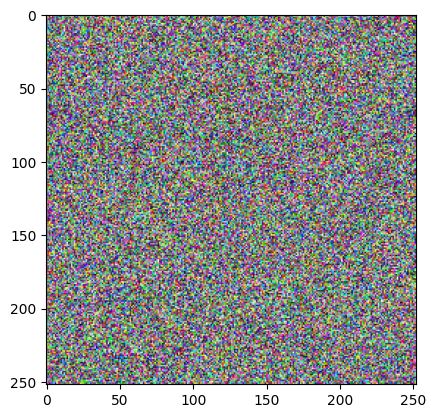

In [26]:
from Crypto.Cipher import AES
from Crypto.Random import get_random_bytes
import cv2
import numpy as np

# Load the image
image_path = 'datasets\jabcode\jabcode_user_1.png'
image = cv2.imread(image_path)

# Define the number of iterations
iterations = 10

# Function to perform AES encryption and decryption
def aes_encrypt_decrypt(data, key):
    cipher = AES.new(key, AES.MODE_EAX)
    encrypted_data, tag = cipher.encrypt_and_digest(data)
    return encrypted_data, cipher.nonce

def aes_decrypt(data, key, nonce):
    cipher = AES.new(key, AES.MODE_EAX, nonce=nonce)
    decrypted_data = cipher.decrypt(data)
    return decrypted_data

# Perform the operations for each iteration
for i in range(iterations):
    # Divide the image into 4 equal parts
    height, width, channels = image.shape
    half_height = height // 2
    half_width = width // 2

    first_quarter = image[:half_height, :half_width]
    second_quarter = image[:half_height, half_width:]
    third_quarter = image[half_height:, :half_width]
    fourth_quarter = image[half_height:, half_width:]

    # AES encrypt the quarters
    encryption_key = get_random_bytes(16)
    encrypted_first = aes_encrypt_decrypt(first_quarter.tobytes(), encryption_key)[0]
    encrypted_second = aes_encrypt_decrypt(second_quarter.tobytes(), encryption_key)[0]
    encrypted_third = aes_encrypt_decrypt(third_quarter.tobytes(), encryption_key)[0]
    encrypted_fourth = aes_encrypt_decrypt(fourth_quarter.tobytes(), encryption_key)[0]

    # Combine the encrypted quarters
    new_image = np.vstack((np.frombuffer(encrypted_second, dtype=np.uint8).reshape(second_quarter.shape),
                           np.frombuffer(encrypted_first, dtype=np.uint8).reshape(first_quarter.shape),
                           np.frombuffer(encrypted_fourth, dtype=np.uint8).reshape(fourth_quarter.shape),
                           np.frombuffer(encrypted_third, dtype=np.uint8).reshape(third_quarter.shape)))

    # Rotate the image 90 degrees
    image = cv2.rotate(new_image, cv2.ROTATE_90_CLOCKWISE)

    # Display the intermediate result (optional)
#     cv2.imshow(f'Iteration {i + 1}', image)
#     cv2.waitKey(0)
#     cv2.destroyAllWindows()
    plt.imshow(original_image)

# Save the final result
cv2.imwrite('final_image.png', image)

# # Display the final result (optional)
# cv2.imshow('Final Image', image)
# cv2.waitKey(0)
# cv2.destroyAllWindows()
plt.imshow(image)

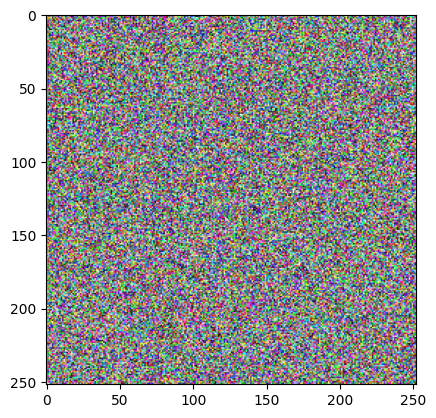

In [27]:
# Load the image
image_path = 'datasets\jabcode\jabcode_user_1.png'
image = cv2.imread(image_path)

# Define the number of iterations
iterations = 10

# Function to perform AES encryption and decryption
def aes_encrypt_decrypt(data, key):
    cipher = AES.new(key, AES.MODE_EAX)
    encrypted_data, tag = cipher.encrypt_and_digest(data)
    return encrypted_data, cipher.nonce

def aes_decrypt(data, key, nonce):
    cipher = AES.new(key, AES.MODE_EAX, nonce=nonce)
    decrypted_data = cipher.decrypt(data)
    return decrypted_data

# Perform the operations for each iteration
for i in range(iterations):
    # Divide the image into 4 equal parts
    height, width, channels = image.shape
    half_height = height // 2
    half_width = width // 2

    first_quarter = image[:half_height, :half_width]
    second_quarter = image[:half_height, half_width:]
    third_quarter = image[half_height:, :half_width]
    fourth_quarter = image[half_height:, half_width:]

    # AES encrypt the quarters
    encryption_key = get_random_bytes(16)
    encrypted_first = aes_encrypt_decrypt(first_quarter.tobytes(), encryption_key)[0]
    encrypted_second = aes_encrypt_decrypt(second_quarter.tobytes(), encryption_key)[0]
    encrypted_third = aes_encrypt_decrypt(third_quarter.tobytes(), encryption_key)[0]
    encrypted_fourth = aes_encrypt_decrypt(fourth_quarter.tobytes(), encryption_key)[0]

    # Combine the encrypted quarters
    new_image = np.vstack((np.frombuffer(encrypted_second, dtype=np.uint8).reshape(second_quarter.shape),
                           np.frombuffer(encrypted_first, dtype=np.uint8).reshape(first_quarter.shape),
                           np.frombuffer(encrypted_fourth, dtype=np.uint8).reshape(fourth_quarter.shape),
                           np.frombuffer(encrypted_third, dtype=np.uint8).reshape(third_quarter.shape)))

    # Rotate the image 90 degrees
    image = cv2.rotate(new_image, cv2.ROTATE_90_CLOCKWISE)

    # Increase pixel values by 4
    image = np.clip(image.astype(int) + 4, 0, 255).astype(np.uint8)

    # Display the intermediate result (optional)
#     cv2.imshow(f'Iteration {i + 1}', image)
#     cv2.waitKey(0)
#     cv2.destroyAllWindows()

# Save the final result
cv2.imwrite('final_image.png', image)

# Display the final result (optional)
# cv2.imshow('Final Image', image)
# cv2.waitKey(0)
# cv2.destroyAllWindows()
plt.imshow(image)

## biocube

In [5]:
def infinte_cube_XOR(img):
    ''' Perform atomic operations on image similar to infinity cube. On performing these steps 'n' times, we can generate the biometric template.
        Input:
            img: The input image
        Output:
            returns the image after performing atomic operation once
    '''
    # Make width dimension even, if it is not
    if img.shape[1]%2 != 0:
        img = img[:, 0:img.shape[1]-1, :]    

    # Expand horizontally
    new_img = cv2.resize(img, (2*img.shape[1], img.shape[0]))

    # Make the height and width of even number
    if new_img.shape[0]%2 != 0:
        new_img = new_img[0:-2, :, :]
    if new_img.shape[1]%2 != 0:
        new_img = new_img[:, 0:-2, :]
#     plt.imshow(new_img)
#     plt.show()
#     new_img.shape

    # Split image vertically into top image and bottom image
    height, width, channels = new_img.shape
    half_height = height//2

    top_img, bottom_img = new_img[:half_height, :], new_img[half_height:, :]

#     plt.imshow(top_img)
#     plt.show()
#     plt.imshow(bottom_img)
#     plt.show()
#     top_img.shape, bottom_img.shape

    # Perform XOR operation between top and bottom section of images
    XOR_img = np.bitwise_xor(top_img, bottom_img)

#     plt.imshow(XOR_img)

    # Split image into 4 equal parts
    height, width, channels = XOR_img.shape
    quarter_width = width//4
    if width%4 != 0:
        quarter_width = int(width//4)
        XOR_img = XOR_img[:, 1:XOR_img.shape[1]-1, :]

    img1, img2, img3, img4 = XOR_img[:, 0:quarter_width], XOR_img[:, quarter_width: 2*quarter_width], XOR_img[:, 2*quarter_width:3*quarter_width], XOR_img[:, 3*quarter_width:]

#     plt.imshow(img1)
#     plt.show()
#     plt.imshow(img2)
#     plt.show()
#     plt.imshow(img3)
#     plt.show()
#     plt.imshow(img4)
#     plt.show()

    # Create new top and bottom images by merging middle two images and two outermost images respectively 
    top_img = cv2.hconcat([img2, img3])
    bottom_img = cv2.hconcat([img1, img4])

#     plt.imshow(top_img)
#     plt.show()
#     plt.imshow(bottom_img)
#     plt.show()
    
    # Form the image of originaly shape by concatenating the two images vertically
#     print(top_img.shape)
#     print(bottom_img.shape)
    new_img = cv2.vconcat([top_img, bottom_img])

#     plt.imshow(new_img)
#     new_img.shape
    
    # Expand vertically
    new_img = cv2.resize(new_img, (new_img.shape[1], 2*new_img.shape[0]))

#     plt.imshow(new_img)
#     plt.show()
#     new_img.shape

    # Split image horizontally into left image and right image
    height, width, channels = new_img.shape
    half_width = width//2

    left_img, right_img = new_img[:, :half_width], new_img[:, half_width:]

#     plt.imshow(left_img)
#     plt.show()
#     plt.imshow(right_img)
#     plt.show()
#     left_img.shape, right_img.shape

    # Perform XOR operation between left and right section of images
    XOR_img = np.bitwise_xor(left_img, right_img)

#     plt.imshow(XOR_img)

    # Split image into 4 equal parts
    height, width, channels = XOR_img.shape
    quarter_height = height//4

    img1, img2, img3, img4 = XOR_img[0:quarter_height, :], XOR_img[quarter_height:2*quarter_height, :], XOR_img[2*quarter_height:3*quarter_height, :], XOR_img[3*quarter_height:, :]

#     plt.imshow(img1)
#     plt.show()
#     plt.imshow(img2)
#     plt.show()
#     plt.imshow(img3)
#     plt.show()
#     plt.imshow(img4)
#     plt.show()

    # Create new left and right images by merging middle two images and two outermost images respectively 
    left_img = cv2.vconcat([img2, img3])
    right_img = cv2.vconcat([img1, img4])

#     plt.imshow(left_img)
#     plt.show()
#     plt.imshow(right_img)
#     plt.show()

    # Form the image of originaly shape by concatenating the two images vertically
    new_img = cv2.hconcat([left_img, right_img])
#     plt.imshow(new_img)
#     new_img.shape

    return new_img

In [9]:
import os
os.chdir('..')
os.getcwd()

'C:\\Users\\HK Joshi\\Documents\\Github\\major_project\\biocube'

(252, 252, 3)

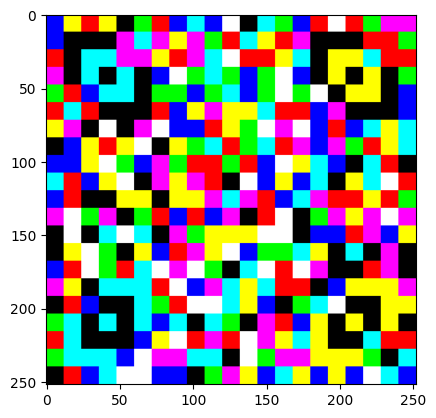

In [10]:
# Load image
image_path = 'datasets\jabcode\jabcode_user_1.png'
img = cv2.imread(image_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
img.shape

255
0


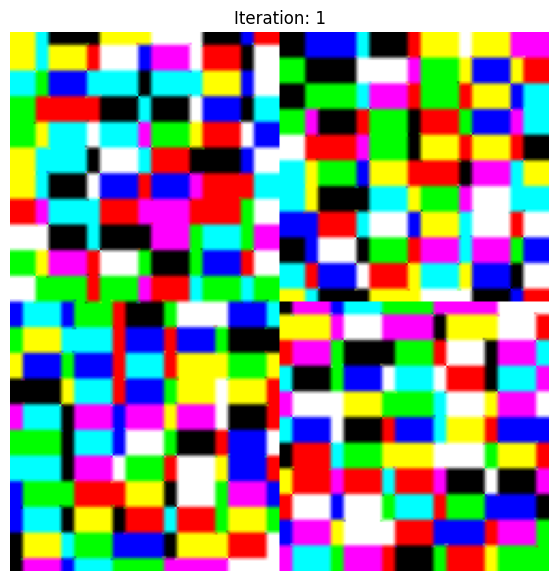

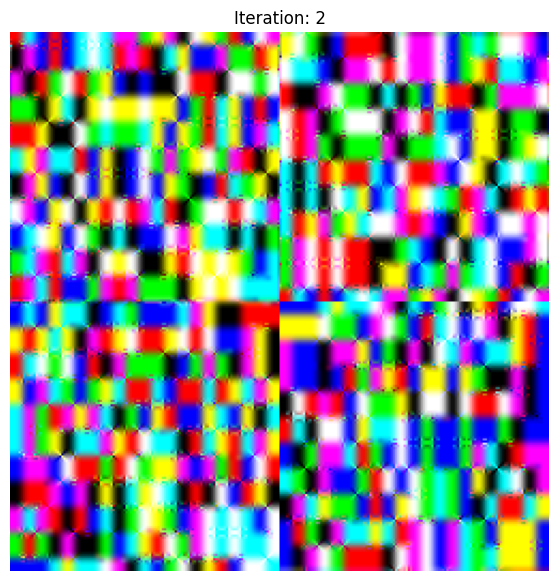

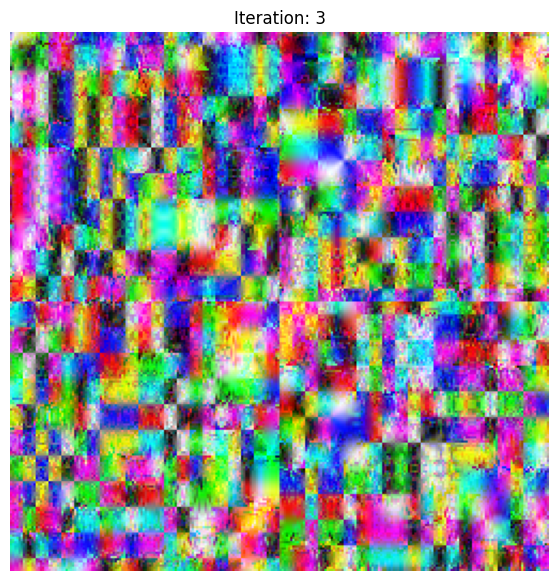

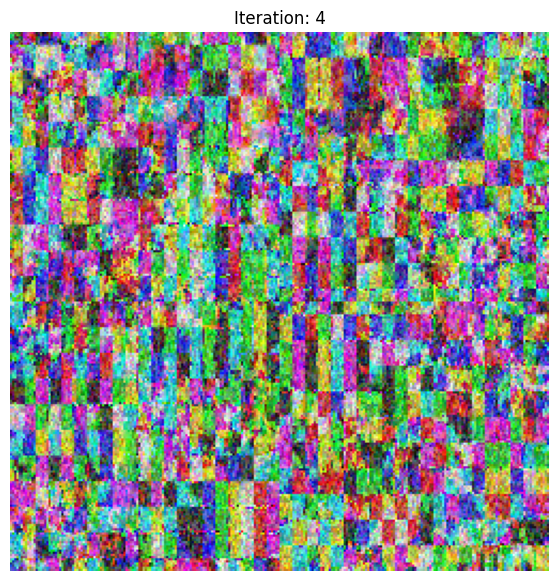

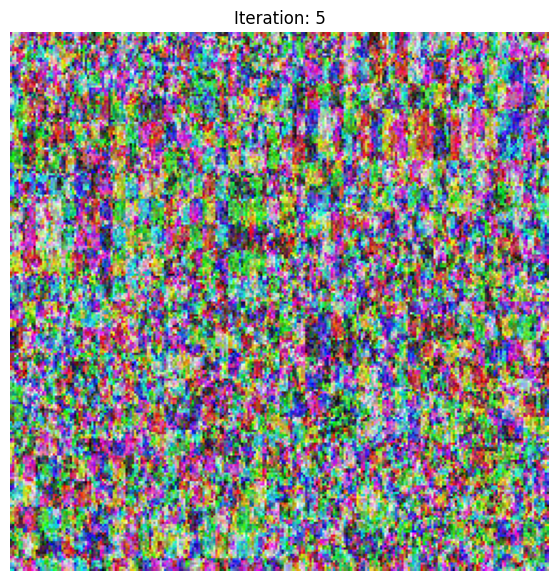

...

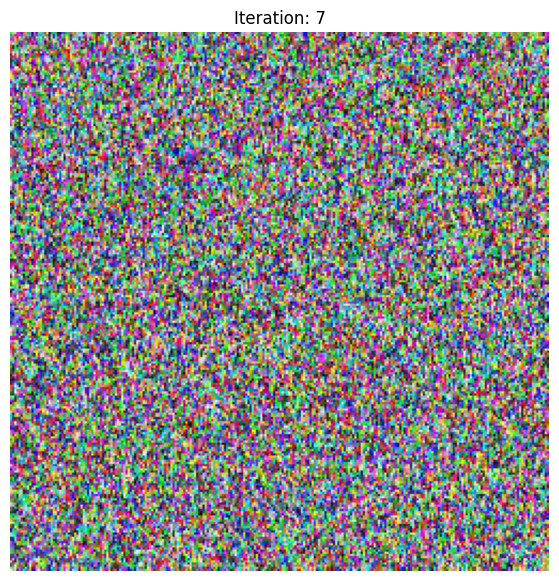

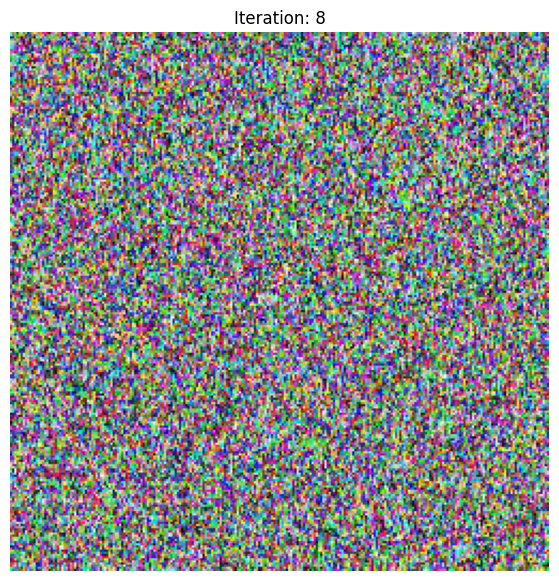

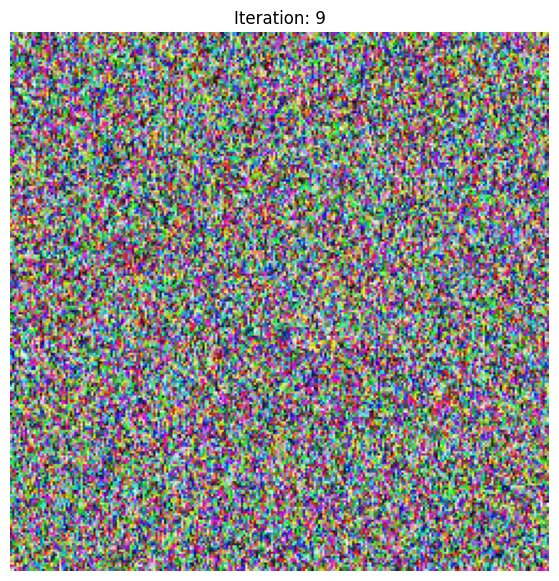

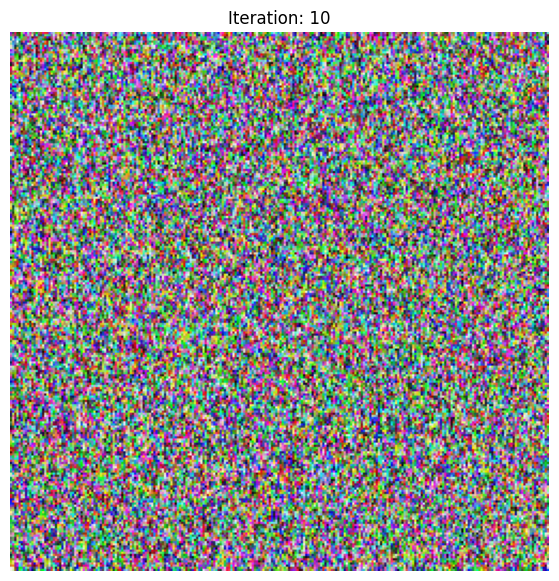

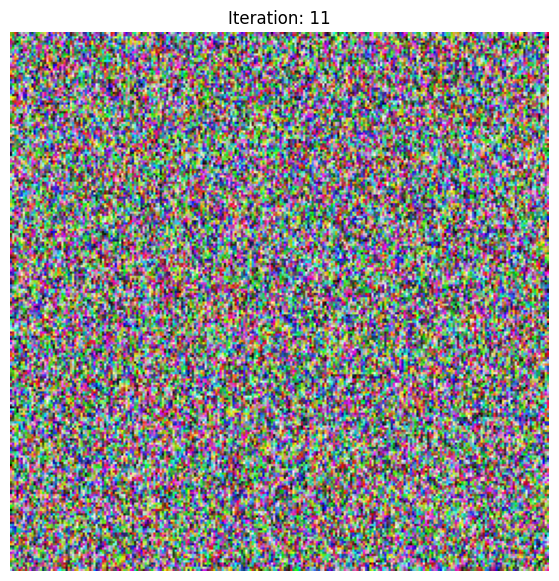

In [11]:
template1 = img.copy()

print(template1.max())
print(template1.min())

for cnt in range(100):
    if cnt <= 10:
        template1 = infinte_cube_XOR(template1)
        plt.figure(figsize=(10, 7))
        
        tmp_max = template1.max()
        tmp_min = template1.min()
        disp_img = (template1 - tmp_min) / (tmp_max - tmp_min)
        
        plt.imshow(disp_img)
        plt.title(f'Iteration: {cnt+1}')
        plt.axis('off')
        filename = f'iteration_{cnt+1}.png'
        plt.savefig(filename)


255
0


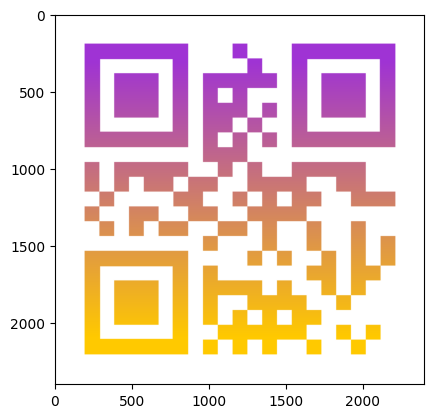

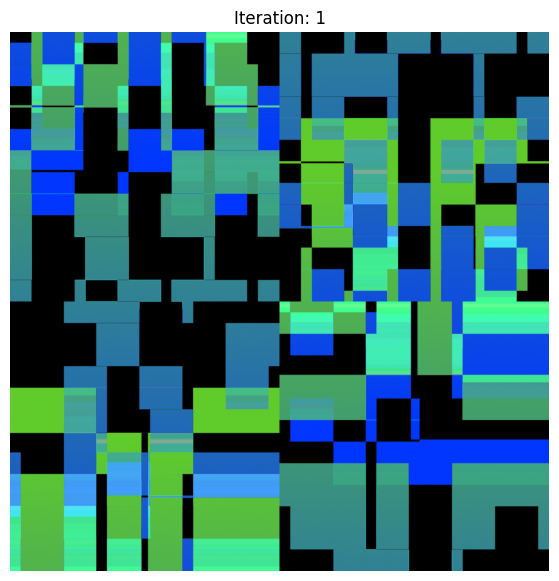

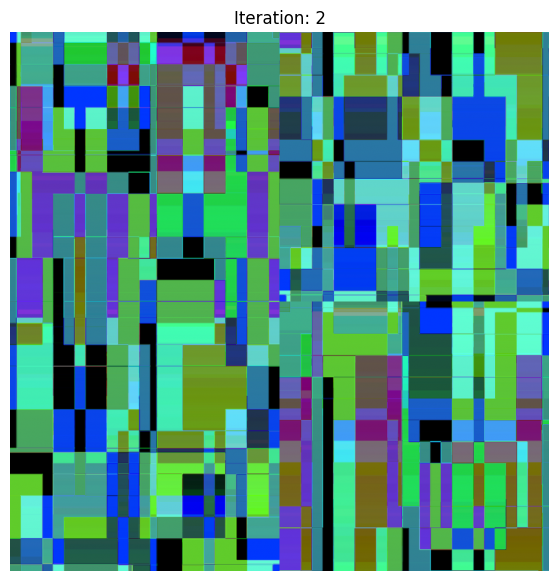

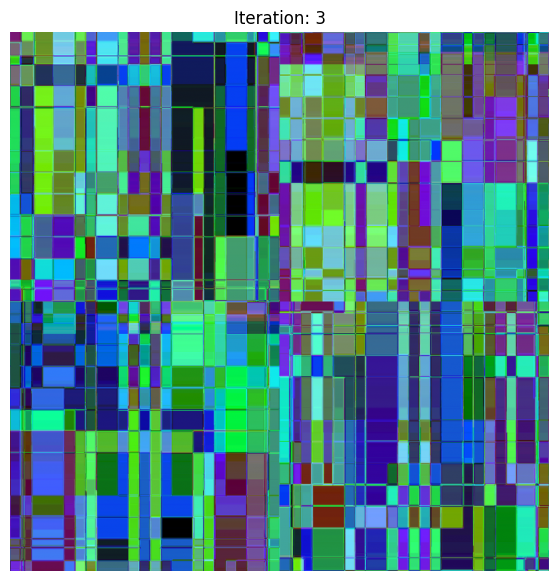

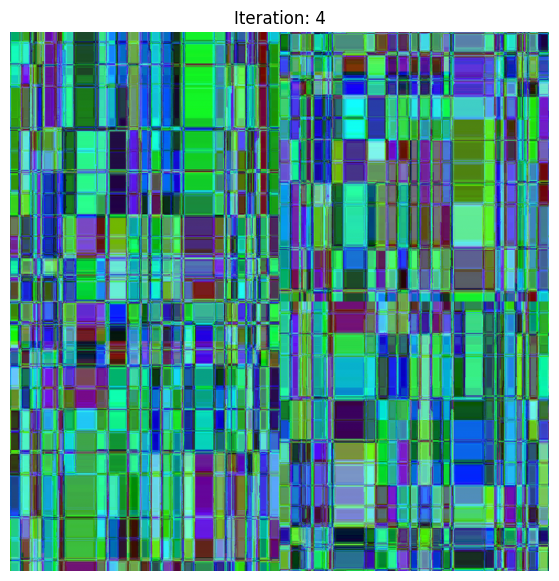

...

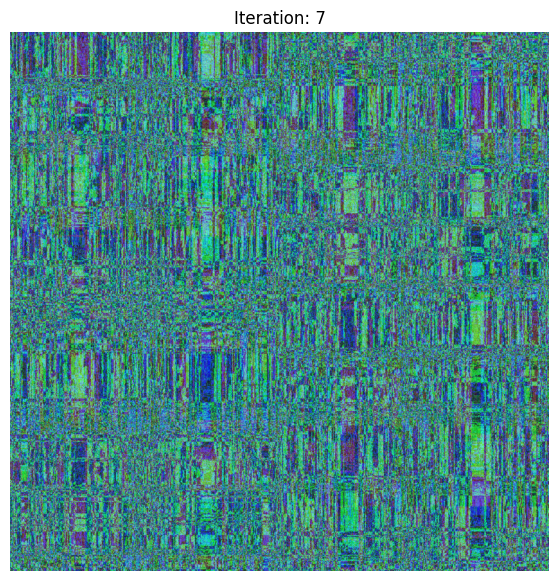

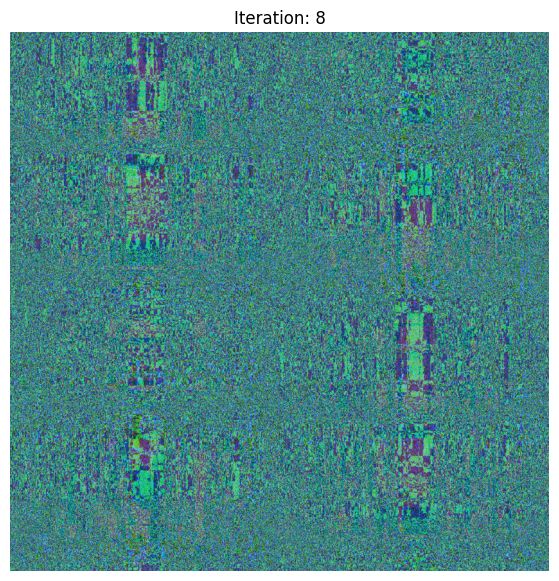

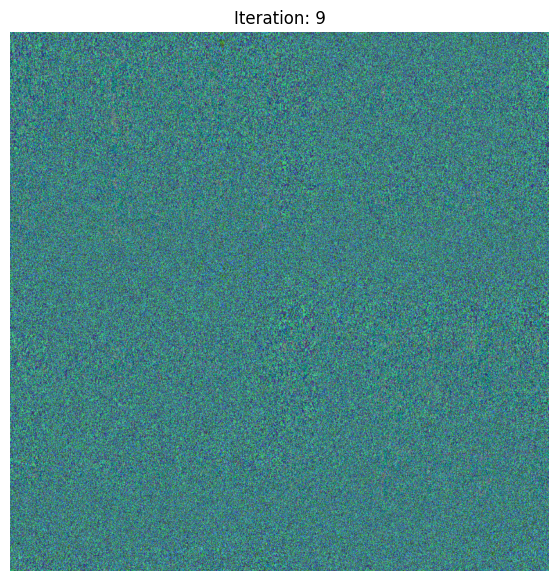

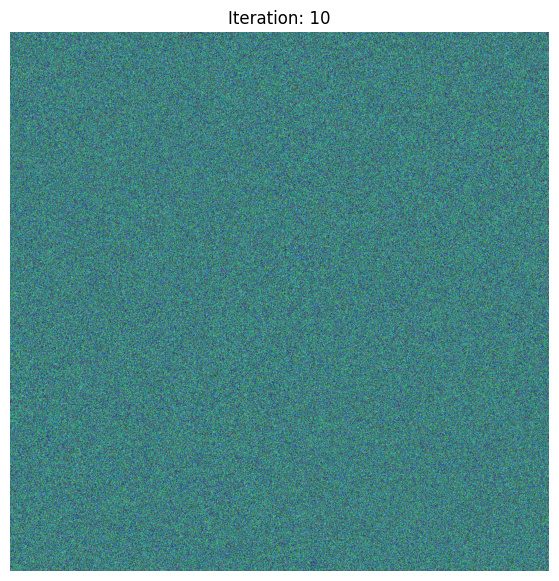

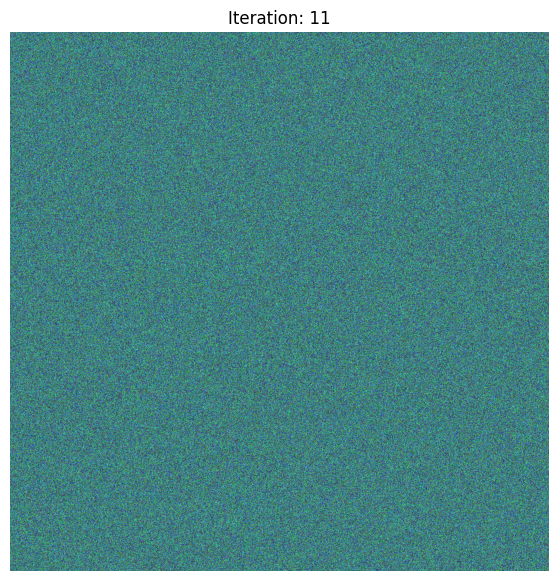

In [28]:
# Load image
image_path = 'datasets\qrcode\qr-code.png'
img = cv2.imread(image_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
img.shape

template1 = img.copy()

print(template1.max())
print(template1.min())

for cnt in range(100):
    if cnt <= 10:
        template1 = infinte_cube_XOR(template1)
        plt.figure(figsize=(10, 7))
        
        tmp_max = template1.max()
        tmp_min = template1.min()
        disp_img = (template1 - tmp_min) / (tmp_max - tmp_min)
        
        plt.imshow(disp_img)
        plt.title(f'Iteration: {cnt+1}')
        plt.axis('off')
        filename = f'iteration_{cnt+1}.png'
        plt.savefig(filename)
